## MileStone 1

### Install dependencies

In [ ]:
!pip install -q condacolab
import condacolab
condacolab.install()

In [ ]:
!conda install transformers plotly openai langchain sentence-transformers ultralytics opencv segment-geospatial groundingdino-py segment-anything-fast pytorch torchvision cudatoolkit=11.1 -c pytorch -c nvidia -c conda-forge

### Load and view train and val data from hugging face

In [ ]:
import os
import torch
from samgeo import SamGeo, tms_to_geotiff
from datasets import load_dataset
import io
from PIL import Image

In [ ]:
# get data from hugging face
dataset = load_dataset("back2classroom/sidewalks")

/usr/local/lib/python3.10/site-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


Generating train split:   0%|          | 0/180000 [00:00<?, ? examples/s]

Generating val split:   0%|          | 0/19999 [00:00<?, ? examples/s]

In [ ]:
train_dataset = dataset["train"]
val_dataset = dataset["val"]

Image name: 1001_10_1.tif


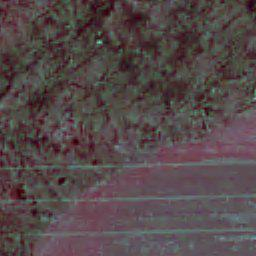

In [ ]:
# sample train image
train_image_name_0 = train_dataset['filename'][0]
train_image_0 =  io.BytesIO(train_dataset['tif'][0])
print(f'Image name: {train_image_name_0}.tif')
Image.open(train_image_0)

Image name: 1016_10_1.tif


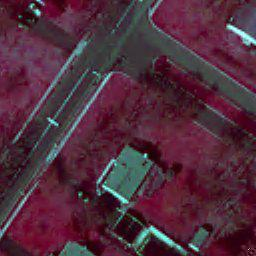

In [ ]:
# sample validation image
val_image_name_0 = val_dataset['filename'][0]
val_image_0 =  io.BytesIO(val_dataset['tif'][0])
print(f'Image name: {val_image_name_0}.tif')
Image.open(val_image_0)

## Milestone 5

In [ ]:
!pip install ipympl
from google.colab import output
output.enable_custom_widget_manager()

In [ ]:
%matplotlib ipympl
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
from transformers import SamModel, SamConfig, SamProcessor
import torch

In [ ]:
model_config = SamConfig.from_pretrained("facebook/sam-vit-base")
processor = SamProcessor.from_pretrained("facebook/sam-vit-base")

my_model = SamModel(config=model_config)
my_model.load_state_dict(torch.load("/content/model_1_epochs.pth"))

config.json:   0%|          | 0.00/6.57k [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/466 [00:00<?, ?B/s]

<All keys matched successfully>

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"
my_model.to(device)

SamModel(
  (shared_image_embedding): SamPositionalEmbedding()
  (vision_encoder): SamVisionEncoder(
    (patch_embed): SamPatchEmbeddings(
      (projection): Conv2d(3, 768, kernel_size=(16, 16), stride=(16, 16))
    )
    (layers): ModuleList(
      (0-11): 12 x SamVisionLayer(
        (layer_norm1): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
        (attn): SamVisionAttention(
          (qkv): Linear(in_features=768, out_features=2304, bias=True)
          (proj): Linear(in_features=768, out_features=768, bias=True)
        )
        (layer_norm2): LayerNorm((768,), eps=1e-06, elementwise_affine=True)
        (mlp): SamMLPBlock(
          (lin1): Linear(in_features=768, out_features=3072, bias=True)
          (lin2): Linear(in_features=3072, out_features=768, bias=True)
          (act): GELUActivation()
        )
      )
    )
    (neck): SamVisionNeck(
      (conv1): Conv2d(768, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (layer_norm1): SamLayerNorm()
     

In [ ]:
def get_bbox_prompt(ground_truth_map):
  y_ind, x_ind = np.where(ground_truth_map > 0)
  x_min, x_max = np.min(x_ind), np.max(x_ind)
  y_min, y_max = np.min(y_ind), np.max(y_ind)

  H, W = 256, 256
  x_min = max(0, x_min - np.random.randint(0, 20))
  x_max = min(W, x_max + np.random.randint(0, 20))
  y_min = max(0, y_min - np.random.randint(0, 20))
  y_max = min(H, y_max + np.random.randint(0, 20))

  bbox = [x_min, y_min, x_max, y_max]

  return bbox

In [ ]:
def onclick(event):
    ix, iy = event.xdata, event.ydata
    get_points.append([ix, iy])

def SidewalkPrompter(image):
  fig, ax = plt.subplots()
  cid = fig.canvas.mpl_connect('button_press_event', onclick)
  plt.imshow(image)
  plt.show()

In [ ]:
def get_results(test_image, get_points):
  prompt = [0, 0, 255, 255]
  inputs = processor(test_image, input_boxes=[[prompt]], return_tensors="pt")
  inputs = {k: v.to(device) for k, v in inputs.items()}

  my_model.eval()
  with torch.no_grad():
    outputs = my_model(**inputs, multimask_output=False)

  # apply sigmoid
  medsam_seg_prob = torch.sigmoid(outputs.pred_masks.squeeze(1))
  medsam_seg_prob = medsam_seg_prob.cpu().numpy().squeeze()
  medsam_seg = (medsam_seg_prob > 0.5).astype(np.uint8)


  bbox_prompt = get_bbox_prompt(medsam_seg)
  tree_points = get_points
  inputs = processor(test_image, input_points=[tree_points], input_boxes=[[bbox_prompt]], return_tensors="pt")
  inputs = {k: v.to(device) for k, v in inputs.items()}

  my_model.eval()
  with torch.no_grad():
    outputs_with_prompts = my_model(**inputs, multimask_output=False)

  # apply sigmoid
  medsam_seg_prob_with_prompt = torch.sigmoid(outputs_with_prompts.pred_masks.squeeze(1))
  medsam_seg_prob_with_prompt = medsam_seg_prob_with_prompt.cpu().numpy().squeeze()
  medsam_seg_with_prompt = (medsam_seg_prob_with_prompt > 0.5).astype(np.uint8)

  return medsam_seg, medsam_seg_with_prompt

#### test image 1: idx = 19074

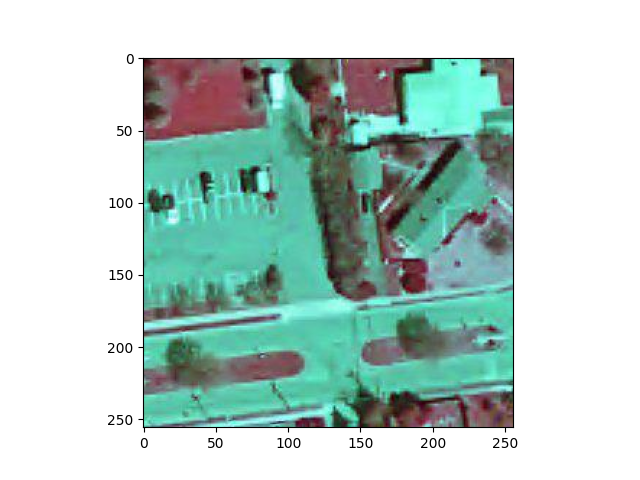

In [ ]:
# load image and select trees
idx = 19074
test_image = np.asarray(Image.open(io.BytesIO(val_dataset[idx]['tif'])))
get_points = []
SidewalkPrompter(test_image)

In [ ]:
# manual points selected from above image
get_points

[[144.12337662337666, 239.43073593073592],
 [157.2835497835498, 239.43073593073592],
 [173.21428571428572, 238.7380952380952],
 [200.22727272727275, 236.66017316017314],
 [178.0627705627706, 236.66017316017314],
 [146.20129870129873, 240.1233766233766]]

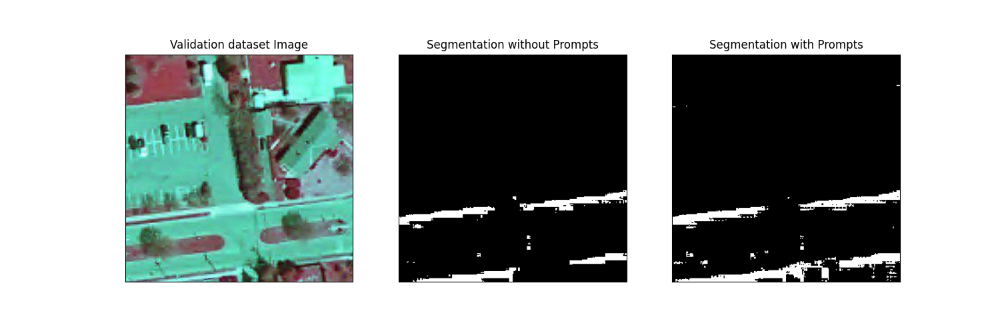

In [ ]:
medsam_seg, medsam_seg_with_prompt = get_results(test_image, get_points)

fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plot the image on the left
axes[0].imshow(np.array(test_image), cmap='gray')
axes[0].set_title("Validation dataset Image")

# Plot the Segmentation without Prompts image on the middle
axes[1].imshow(medsam_seg, cmap='gray')
axes[1].set_title("Segmentation without Prompts")

# Plot the Segmentation with Prompts image on the middle
axes[2].imshow(medsam_seg_with_prompt, cmap='gray')
axes[2].set_title("Segmentation with Prompts")

# Hide axis ticks and labels
for ax in axes:
  ax.set_xticks([])
  ax.set_yticks([])
  ax.set_xticklabels([])
  ax.set_yticklabels([])

# Display the images side by side
plt.show()

#### test image 2: idx = 4781

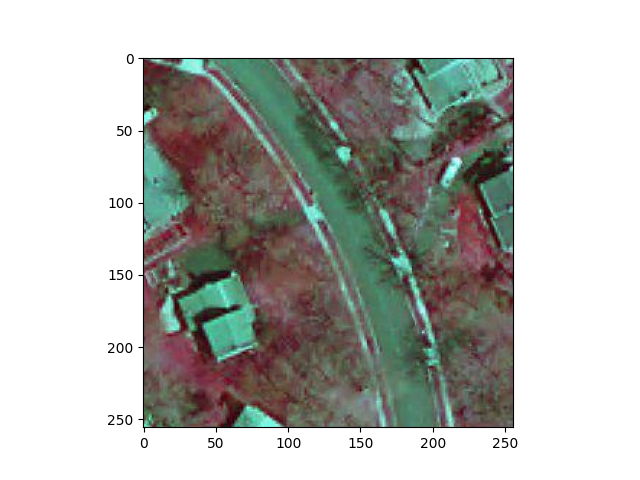

In [ ]:
# load image and select trees
idx = 4781
test_image = np.asarray(Image.open(io.BytesIO(val_dataset[idx]['tif'])))
get_points = []
SidewalkPrompter(test_image)

In [ ]:
# manual points selected from above image
get_points

[[146.20129870129873, 75.96753246753244],
 [155.20562770562773, 91.20562770562768],
 [156.59090909090912, 90.51298701298697],
 [157.2835497835498, 98.8246753246753],
 [157.2835497835498, 201.3354978354978],
 [157.2835497835498, 215.18831168831167],
 [157.97619047619048, 223.49999999999997]]

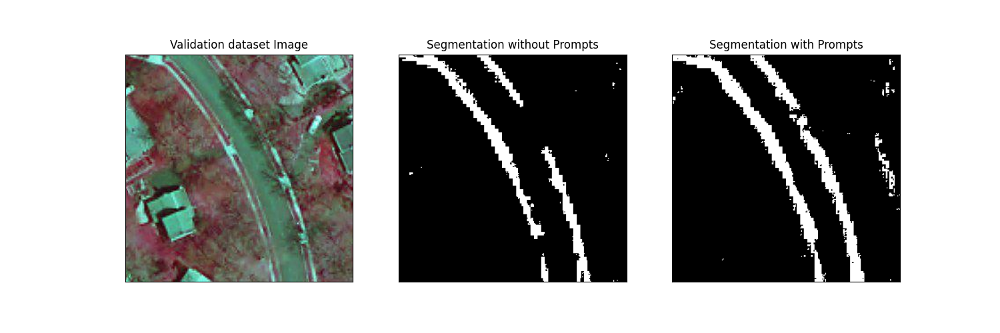

In [ ]:
medsam_seg, medsam_seg_with_prompt = get_results(test_image, get_points)

fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plot the image on the left
axes[0].imshow(np.array(test_image), cmap='gray')
axes[0].set_title("Validation dataset Image")

# Plot the Segmentation without Prompts image on the middle
axes[1].imshow(medsam_seg, cmap='gray')
axes[1].set_title("Segmentation without Prompts")

# Plot the Segmentation with Prompts image on the middle
axes[2].imshow(medsam_seg_with_prompt, cmap='gray')
axes[2].set_title("Segmentation with Prompts")

# Hide axis ticks and labels
for ax in axes:
  ax.set_xticks([])
  ax.set_yticks([])
  ax.set_xticklabels([])
  ax.set_yticklabels([])

# Display the images side by side
plt.show()

#### test image 3: idx = 6443

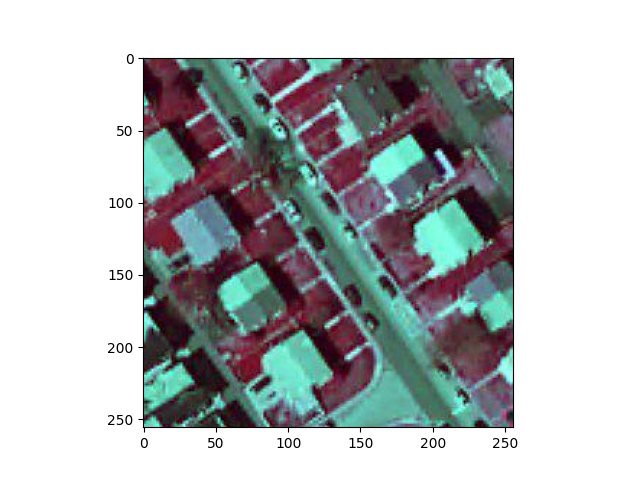

In [ ]:
# load image and select trees
idx = 6443
test_image = np.asarray(Image.open(io.BytesIO(val_dataset[idx]['tif'])))
get_points = []
SidewalkPrompter(test_image)

In [ ]:
# manual points selected from above image
get_points

[[71.39610389610391, 63.49999999999994],
 [77.62987012987014, 75.96753246753244],
 [81.0930735930736, 82.20129870129867],
 [29.83766233766235, 7.3961038961038525],
 [33.99350649350649, 10.859307359307309],
 [36.76406926406926, 17.78571428571422]]

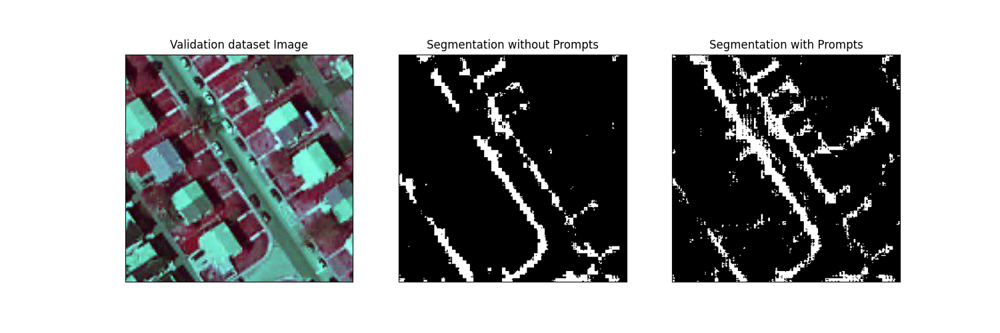

In [ ]:
medsam_seg, medsam_seg_with_prompt = get_results(test_image, get_points)

fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plot the image on the left
axes[0].imshow(np.array(test_image), cmap='gray')
axes[0].set_title("Validation dataset Image")

# Plot the Segmentation without Prompts image on the middle
axes[1].imshow(medsam_seg, cmap='gray')
axes[1].set_title("Segmentation without Prompts")

# Plot the Segmentation with Prompts image on the middle
axes[2].imshow(medsam_seg_with_prompt, cmap='gray')
axes[2].set_title("Segmentation with Prompts")

# Hide axis ticks and labels
for ax in axes:
  ax.set_xticks([])
  ax.set_yticks([])
  ax.set_xticklabels([])
  ax.set_yticklabels([])

# Display the images side by side
plt.show()

#### test image 4: idx = 3030

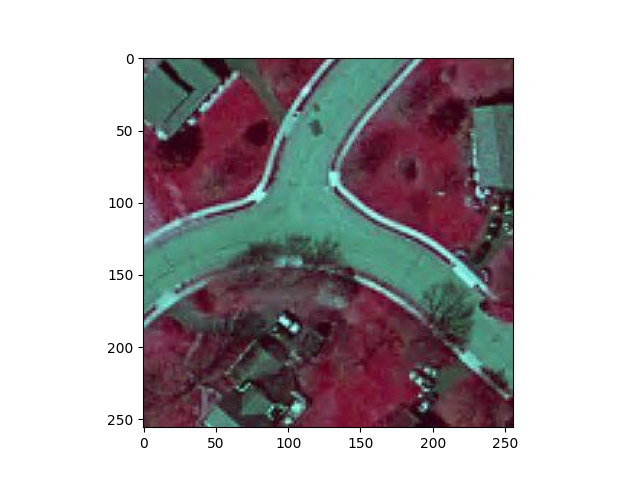

In [ ]:
# load image and select trees
idx = 3030
test_image = np.asarray(Image.open(io.BytesIO(val_dataset[idx]['tif'])))
get_points = []
SidewalkPrompter(test_image)

In [ ]:
# manual points selected from above image
get_points

[[52.002164502164504, 150.77272727272725],
 [71.39610389610391, 145.2316017316017],
 [85.24891774891776, 142.46103896103892],
 [106.02813852813856, 139.69047619047615],
 [123.34415584415586, 139.69047619047615],
 [193.30086580086584, 179.17099567099564],
 [203.6904761904762, 186.09740259740255],
 [212.00216450216453, 196.48701298701297],
 [216.15800865800867, 201.3354978354978]]

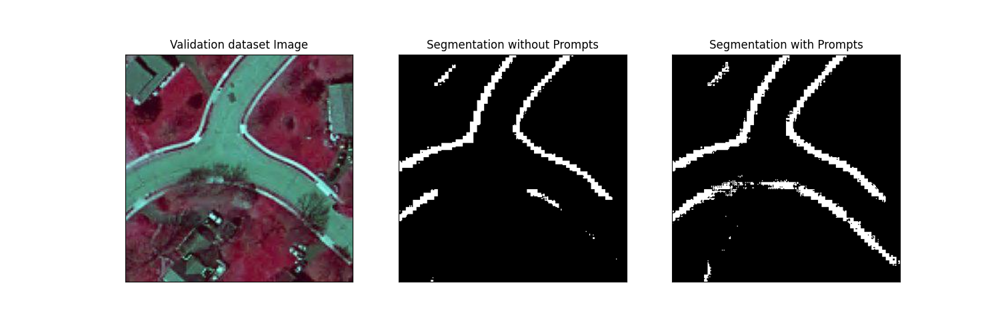

In [ ]:
medsam_seg, medsam_seg_with_prompt = get_results(test_image, get_points)

fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plot the image on the left
axes[0].imshow(np.array(test_image), cmap='gray')
axes[0].set_title("Validation dataset Image")

# Plot the Segmentation without Prompts image on the middle
axes[1].imshow(medsam_seg, cmap='gray')
axes[1].set_title("Segmentation without Prompts")

# Plot the Segmentation with Prompts image on the middle
axes[2].imshow(medsam_seg_with_prompt, cmap='gray')
axes[2].set_title("Segmentation with Prompts")

# Hide axis ticks and labels
for ax in axes:
  ax.set_xticks([])
  ax.set_yticks([])
  ax.set_xticklabels([])
  ax.set_yticklabels([])

# Display the images side by side
plt.show()

#### test image 5: idx = 13092

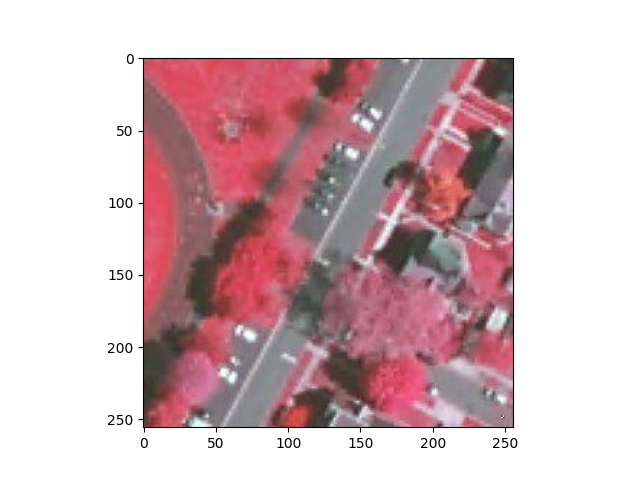

In [ ]:
# load image and select trees
idx = 13092
test_image = np.asarray(Image.open(io.BytesIO(val_dataset[idx]['tif'])))
get_points = []
SidewalkPrompter(test_image)

In [ ]:
# manual points selected from above image
get_points

[[93.56060606060606, 181.24891774891773],
 [103.25757575757578, 159.08441558441555],
 [112.95454545454547, 141.76839826839824],
 [126.80735930735932, 199.25757575757575],
 [139.27489177489178, 172.9372294372294],
 [158.66883116883122, 143.8463203463203]]

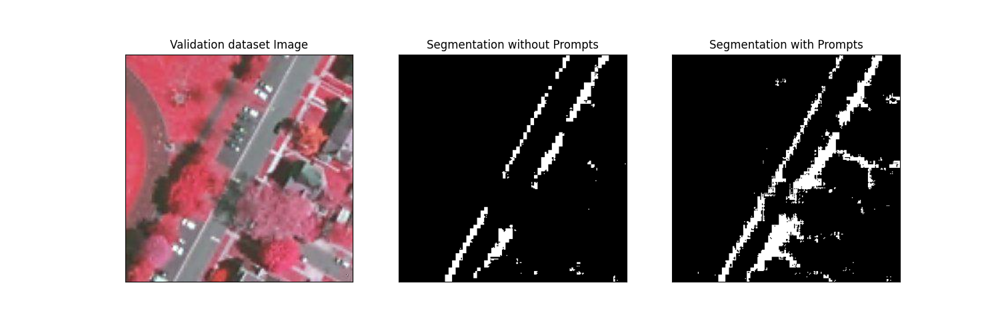

In [ ]:
medsam_seg, medsam_seg_with_prompt = get_results(test_image, get_points)

fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plot the image on the left
axes[0].imshow(np.array(test_image), cmap='gray')
axes[0].set_title("Validation dataset Image")

# Plot the Segmentation without Prompts image on the middle
axes[1].imshow(medsam_seg, cmap='gray')
axes[1].set_title("Segmentation without Prompts")

# Plot the Segmentation with Prompts image on the middle
axes[2].imshow(medsam_seg_with_prompt, cmap='gray')
axes[2].set_title("Segmentation with Prompts")

# Hide axis ticks and labels
for ax in axes:
  ax.set_xticks([])
  ax.set_yticks([])
  ax.set_xticklabels([])
  ax.set_yticklabels([])

# Display the images side by side
plt.show()

#### test image 6: idx = 19922

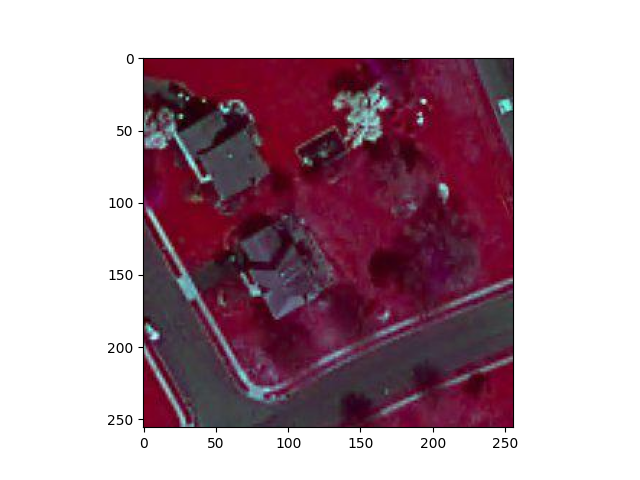

In [ ]:
# load image and select trees
idx = 19922
test_image = np.asarray(Image.open(io.BytesIO(val_dataset[idx]['tif'])))
get_points = []
SidewalkPrompter(test_image)

In [ ]:
# manual points selected from above image
get_points

[[107.41341991341992, 220.03679653679652],
 [113.64718614718618, 219.3441558441558],
 [149.66450216450218, 199.25757575757575],
 [155.20562770562773, 198.56493506493504],
 [151.74242424242425, 250.512987012987],
 [197.45670995670997, 231.81168831168827],
 [203.6904761904762, 231.81168831168827]]

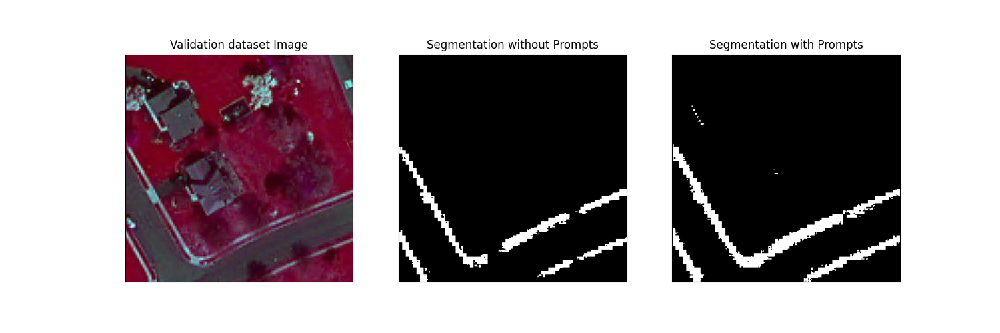

In [ ]:
medsam_seg, medsam_seg_with_prompt = get_results(test_image, get_points)

fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plot the image on the left
axes[0].imshow(np.array(test_image), cmap='gray')
axes[0].set_title("Validation dataset Image")

# Plot the Segmentation without Prompts image on the middle
axes[1].imshow(medsam_seg, cmap='gray')
axes[1].set_title("Segmentation without Prompts")

# Plot the Segmentation with Prompts image on the middle
axes[2].imshow(medsam_seg_with_prompt, cmap='gray')
axes[2].set_title("Segmentation with Prompts")

# Hide axis ticks and labels
for ax in axes:
  ax.set_xticks([])
  ax.set_yticks([])
  ax.set_xticklabels([])
  ax.set_yticklabels([])

# Display the images side by side
plt.show()

#### test image 7: idx = 513

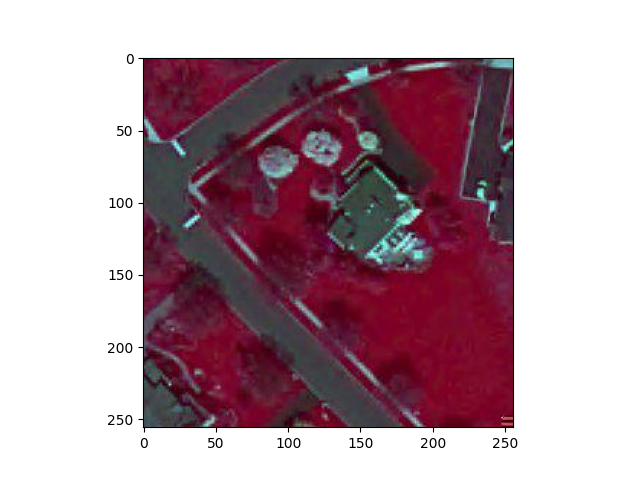

In [ ]:
# load image and select trees
idx = 513
test_image = np.asarray(Image.open(io.BytesIO(val_dataset[idx]['tif'])))
get_points = []
SidewalkPrompter(test_image)

In [ ]:
# manual points selected from above image
get_points

[[180.1406926406927, 244.97186147186144],
 [170.44372294372295, 235.27489177489176],
 [162.13203463203467, 225.57792207792204],
 [137.19696969696972, 200.6428571428571],
 [126.80735930735932, 190.25324675324674],
 [98.40909090909093, 161.16233766233762],
 [91.482683982684, 153.54329004329],
 [83.1709956709957, 143.8463203463203],
 [41.61255411255411, 98.13203463203459],
 [50.616883116883116, 110.59956709956705],
 [38.14935064935065, 149.38744588744586],
 [50.616883116883116, 165.31818181818178],
 [83.1709956709957, 196.48701298701297],
 [95.63852813852816, 208.95454545454544]]

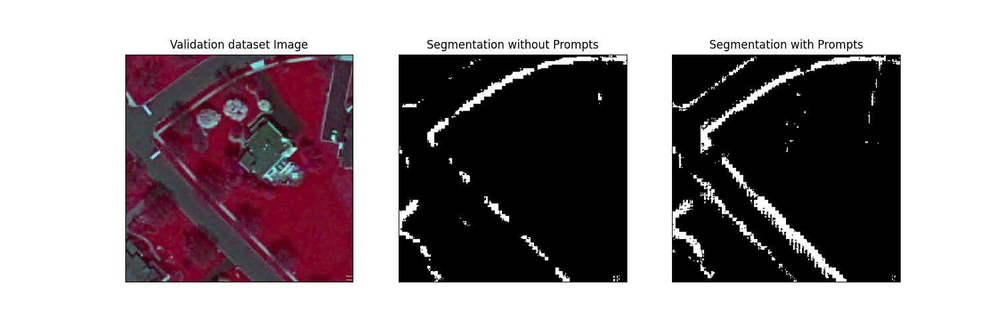

In [ ]:
medsam_seg, medsam_seg_with_prompt = get_results(test_image, get_points)

fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plot the image on the left
axes[0].imshow(np.array(test_image), cmap='gray')
axes[0].set_title("Validation dataset Image")

# Plot the Segmentation without Prompts image on the middle
axes[1].imshow(medsam_seg, cmap='gray')
axes[1].set_title("Segmentation without Prompts")

# Plot the Segmentation with Prompts image on the middle
axes[2].imshow(medsam_seg_with_prompt, cmap='gray')
axes[2].set_title("Segmentation with Prompts")

# Hide axis ticks and labels
for ax in axes:
  ax.set_xticks([])
  ax.set_yticks([])
  ax.set_xticklabels([])
  ax.set_yticklabels([])

# Display the images side by side
plt.show()

#### test image 8: idx = 3637


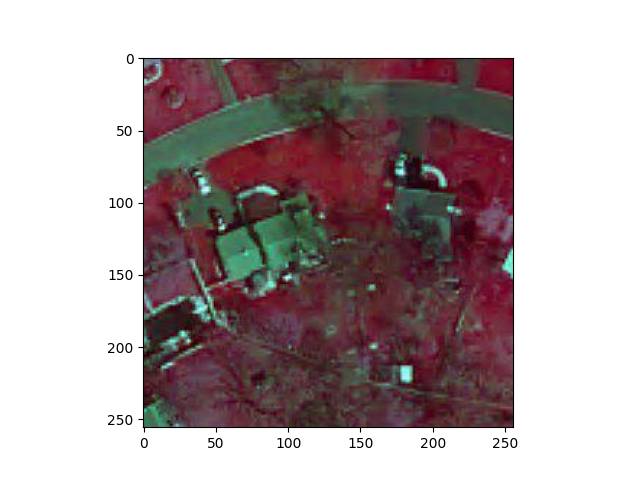

In [ ]:
# load image and select trees
idx = 3637
test_image = np.asarray(Image.open(io.BytesIO(val_dataset[idx]['tif'])))
get_points = []
SidewalkPrompter(test_image)

In [ ]:
# manual points selected from above image
get_points

[[74.85930735930737, 28.867965367965326],
 [92.1753246753247, 21.941558441558414],
 [105.33549783549785, 18.478354978354957],
 [122.65151515151516, 15.707792207792181],
 [151.74242424242425, 15.707792207792181],
 [129.5779220779221, 15.015151515151445],
 [112.26190476190479, 45.491341991341955],
 [130.96320346320348, 45.491341991341955],
 [147.5865800865801, 45.491341991341955],
 [167.67316017316017, 45.491341991341955]]

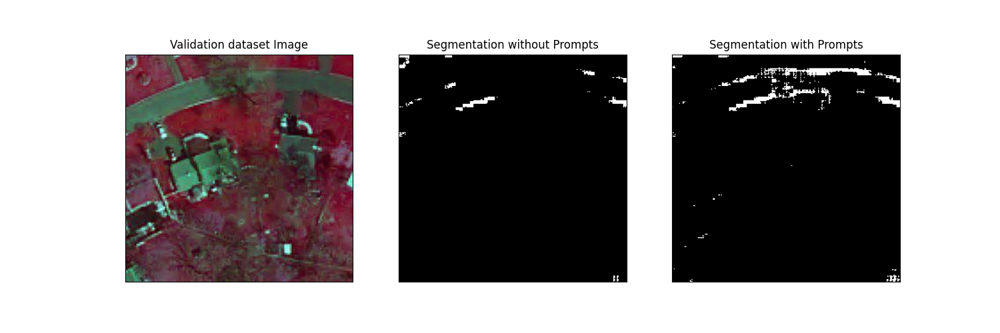

In [ ]:
medsam_seg, medsam_seg_with_prompt = get_results(test_image, get_points)

fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plot the image on the left
axes[0].imshow(np.array(test_image), cmap='gray')
axes[0].set_title("Validation dataset Image")

# Plot the Segmentation without Prompts image on the middle
axes[1].imshow(medsam_seg, cmap='gray')
axes[1].set_title("Segmentation without Prompts")

# Plot the Segmentation with Prompts image on the middle
axes[2].imshow(medsam_seg_with_prompt, cmap='gray')
axes[2].set_title("Segmentation with Prompts")

# Hide axis ticks and labels
for ax in axes:
  ax.set_xticks([])
  ax.set_yticks([])
  ax.set_xticklabels([])
  ax.set_yticklabels([])

# Display the images side by side
plt.show()

#### test image 9: idx = 1172

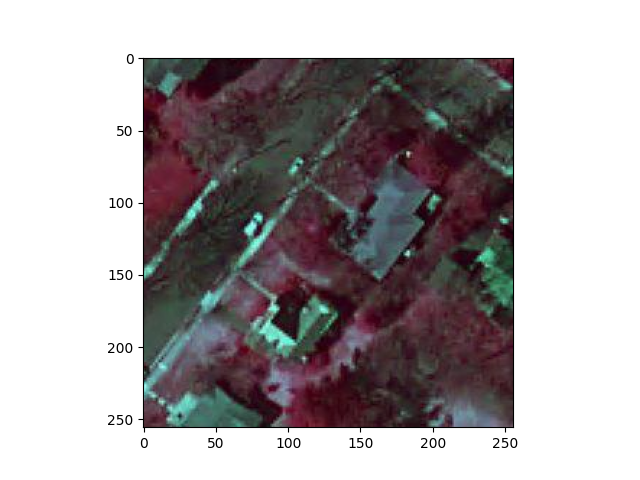

In [ ]:
# load image and select trees
idx = 1172
test_image = np.asarray(Image.open(io.BytesIO(val_dataset[idx]['tif'])))
get_points = []
SidewalkPrompter(test_image)

In [ ]:
# manual points selected from above image
get_points

[[246.63419913419915, 73.88961038961034],
 [226.5476190476191, 59.34415584415581],
 [207.8463203463204, 48.2619047619047],
 [187.75974025974028, 28.867965367965326],
 [170.44372294372295, 17.78571428571422],
 [186.37445887445892, 30.253246753246685],
 [163.51731601731603, 13.629870129870085],
 [151.74242424242425, 28.867965367965326],
 [143.43073593073595, 41.33549783549779]]

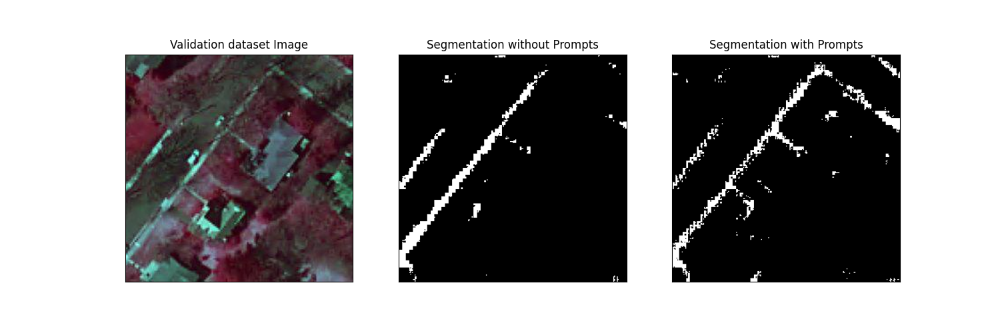

In [ ]:
medsam_seg, medsam_seg_with_prompt = get_results(test_image, get_points)

fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plot the image on the left
axes[0].imshow(np.array(test_image), cmap='gray')
axes[0].set_title("Validation dataset Image")

# Plot the Segmentation without Prompts image on the middle
axes[1].imshow(medsam_seg, cmap='gray')
axes[1].set_title("Segmentation without Prompts")

# Plot the Segmentation with Prompts image on the middle
axes[2].imshow(medsam_seg_with_prompt, cmap='gray')
axes[2].set_title("Segmentation with Prompts")

# Hide axis ticks and labels
for ax in axes:
  ax.set_xticks([])
  ax.set_yticks([])
  ax.set_xticklabels([])
  ax.set_yticklabels([])

# Display the images side by side
plt.show()

#### test image 10: idx = 8104

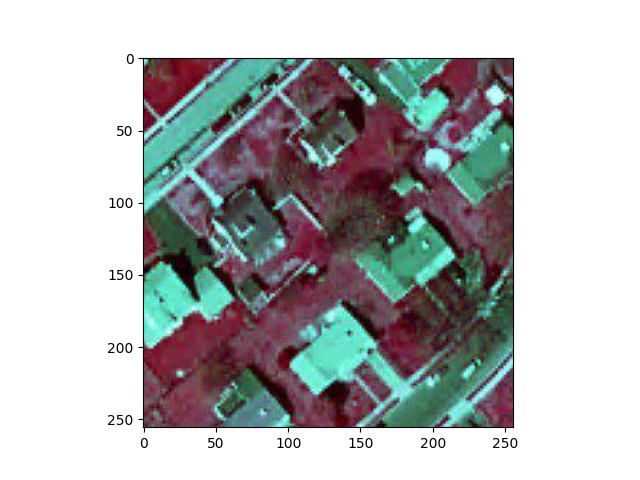

In [ ]:
# load image and select trees
idx = 8104
test_image = np.asarray(Image.open(io.BytesIO(val_dataset[idx]['tif'])))
get_points = []
SidewalkPrompter(test_image)

In [ ]:
# manual points selected from above image
get_points

[[198.14935064935065, 213.80303030303028],
 [212.00216450216453, 199.25757575757575],
 [223.77705627705632, 188.17532467532465],
 [234.16666666666669, 173.62987012987008],
 [240.40043290043292, 161.85497835497833],
 [250.0974025974026, 150.77272727272725]]

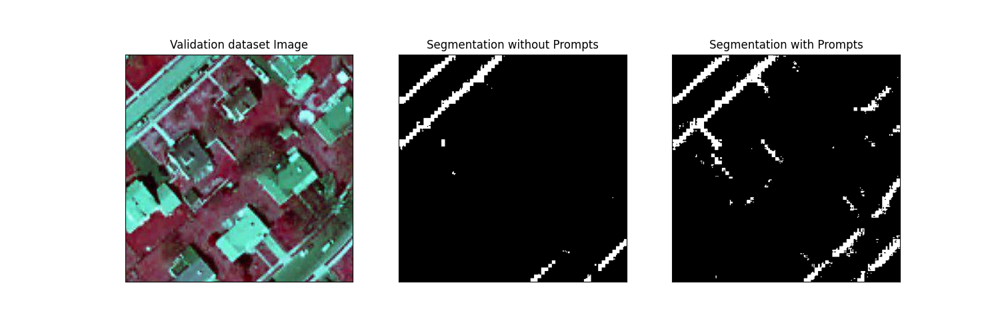

In [ ]:
medsam_seg, medsam_seg_with_prompt = get_results(test_image, get_points)

fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plot the image on the left
axes[0].imshow(np.array(test_image), cmap='gray')
axes[0].set_title("Validation dataset Image")

# Plot the Segmentation without Prompts image on the middle
axes[1].imshow(medsam_seg, cmap='gray')
axes[1].set_title("Segmentation without Prompts")

# Plot the Segmentation with Prompts image on the middle
axes[2].imshow(medsam_seg_with_prompt, cmap='gray')
axes[2].set_title("Segmentation with Prompts")

# Hide axis ticks and labels
for ax in axes:
  ax.set_xticks([])
  ax.set_yticks([])
  ax.set_xticklabels([])
  ax.set_yticklabels([])

# Display the images side by side
plt.show()

#### Visual prompting for a random image in test set

In [ ]:
import random

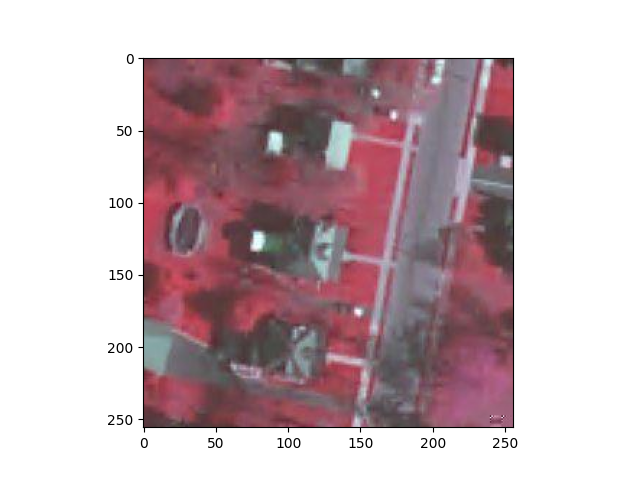

In [ ]:
# load image and select trees
idx = random.randint(0, 19999)
test_image = np.asarray(Image.open(io.BytesIO(val_dataset[idx]['tif'])))
get_points = []
SidewalkPrompter(test_image)

In [ ]:
# manual points selected from above image
get_points

[[214.7727272727273, 120.29653679653677],
 [211.30952380952385, 144.538961038961],
 [205.07575757575762, 175.0151515151515],
 [200.91991341991343, 205.49134199134198],
 [200.22727272727275, 222.11471861471858],
 [191.91558441558442, 247.74242424242422]]

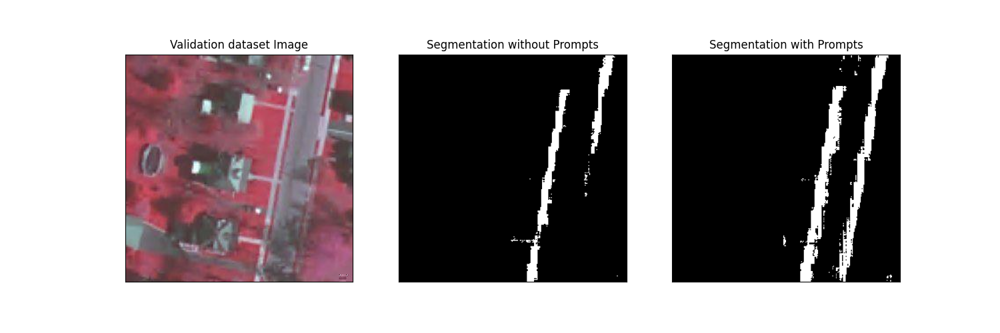

In [ ]:
medsam_seg, medsam_seg_with_prompt = get_results(test_image, get_points)

fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plot the image on the left
axes[0].imshow(np.array(test_image), cmap='gray')
axes[0].set_title("Validation dataset Image")

# Plot the Segmentation without Prompts image on the middle
axes[1].imshow(medsam_seg, cmap='gray')
axes[1].set_title("Segmentation without Prompts")

# Plot the Segmentation with Prompts image on the middle
axes[2].imshow(medsam_seg_with_prompt, cmap='gray')
axes[2].set_title("Segmentation with Prompts")

# Hide axis ticks and labels
for ax in axes:
  ax.set_xticks([])
  ax.set_yticks([])
  ax.set_xticklabels([])
  ax.set_yticklabels([])

# Display the images side by side
plt.show()